In [1]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import netCDF4 as nc
import matplotlib.pyplot as plt
import numpy as np
import copy
import os
import glob
import pylab as pl
import numpy as np
import matplotlib.animation as animation
import types
from mpl_toolkits.basemap import cm,addcyclic,Basemap, shiftgrid
import matplotlib.patches as patches
% matplotlib inline

In [2]:
nc_filename=sorted(glob.glob\
    ('/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/result/S_ANHA4-ENG3_1y_19790101_19841231_ptrc_T.nc'))#*_ptrc_T*.nc'))

print("found *.nc file: \n{}".format(nc_filename))
ptrc=nc.Dataset(nc_filename[0])

#uvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridU_19582008.nc')


#vvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridV_19582008.nc')


#wvel=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridW_19582008.nc')


#tfield=nc.Dataset('/ocean/xiaoxiny/research/result_jasper/data_eng3/ANHA4-ENG3_gridT_19582008.nc')
#print tfield.variables

found *.nc file: 
['/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/result/S_ANHA4-ENG3_1y_19790101_19841231_ptrc_T.nc']


In [3]:
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
dep = ptrc.variables['deptht'][:]


tmask=nc.Dataset(
        '/ocean/xiaoxiny/research/NEMO-code/NEMOGCM/CONFIG/myANHA/EXP00/crop.nc')
mbathy=tmask.variables['mbathy'][0,400:,:]
tmask=tmask.variables['tmask'][0,:,400:,:]


bathy=nc.Dataset(
    '/ocean/xiaoxiny/research/data/Jasper/ANHA4_bathy_etopo1_gebco1_smoothed_coast_corrected_mar10.nc')
bathy=bathy.variables['Bathymetry'][400:,:]

In [4]:
yearnum=len(ptrc.variables['TR_7'][:,0,0,0])

In [5]:
nclist=['/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/result/S_ANHA4-ENG3_1y_19790101_19841231_ptrc_T.nc',
      # '/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/sensitivity_exp_cs/S_csIce-ENG3_1y_19790101_19841231_ptrc_T.nc',
       '/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/sensitivity_exp_hv/S_ANHA4-ENG3_1y_19790101_19841231_ptrc_T.nc']

In [6]:
import scipy.signal  # used for detrend

The disconsistancy is because the orange point is not in the pathway..

In [43]:
# IC for diss/part Pa

def sens_th(nclist,Runname,Year, string, title, origyear=1979,layer=31, vkey='False',vmin=0,vmax=0):
      for year in Year:
        fig, axes = plt.subplots(nrows=1, ncols=len(nclist),figsize=(19.5,6.5))
        for ax,nc_filename,runname in zip(axes.flat, nclist, Runname):
           
            time = year
            ptrc=nc.Dataset(nc_filename)
            data =ptrc.variables[string][time,:,:,:]
            data =np.ma.masked_where(tmask==0,data)
            data[:,:125,:]=np.ma.masked

            m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l',round=True, ax=ax)
            m.drawcoastlines()
            m.fillcontinents(color = '0.75')
            m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
            m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
            x_lon,y_lat = m(lon,lat)
            # bathy
            m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
            ax.text(0.95,-0.02, '%s'%(runname), transform=ax.transAxes, ha='right', fontsize=13)
            # pcolor, tracer
            if vkey == 'False':
                cs=m.pcolor(x_lon,y_lat,data[layer,:,:],cmap='Spectral_r')#,vmin=.24,vmax=.45);
                cbar=m.colorbar(cs,location='bottom',extend='both')
                cbar.set_label('%s conc. (dmp/1000L)'%(title))
                cbar.formatter.set_powerlimits((-1, 1))
                cbar.update_ticks()
            else:
                cs=m.pcolor(x_lon,y_lat,data[layer,:,:],cmap='Spectral_r',vmin=vmin,vmax=vmax);
            # Make an axis for the colorbar on the right side
                cax = fig.add_axes([0.3, 0.05, 0.4, 0.035])
                cbar=fig.colorbar(cs, orientation='horizontal',cax=cax, extend='both')
                cbar.set_label('tracer conc. (dpm/1000kg)')
            
        m.drawmapscale(00., 75, 0, 75, 500, fontsize = 14)
        fig.suptitle('%s conc. at intermediate depth (%.0f m) (%s)'%(title,dep[layer],origyear+year),fontsize=12.5)
        

        plt.show()
        
        

def sens_ratio(nclist,Runname,Year, string, title, origyear=1979,layer=31, vkey='False',vmin=0,vmax=0):
      for year in Year:
        fig, axes = plt.subplots(nrows=1, ncols=len(nclist),figsize=(19.5,6.5))
        for ax,nc_filename,runname in zip(axes.flat, nclist, Runname):
           
            time = year
            ptrc=nc.Dataset(nc_filename)
            if string =='d':
                data =ptrc.variables['TR_7'][time,:,:,:]/ptrc.variables['TR_8'][time,:,:,:]
            else:
                data =ptrc.variables['TR_9'][time,:,:,:]/ptrc.variables['TR_10'][time,:,:,:]
            data =np.ma.masked_where(tmask==0,data)
            data[:,:125,:]=np.ma.masked

            m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l',round=True, ax=ax)
            m.drawcoastlines()
            m.fillcontinents(color = '0.75')
            m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
            m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
            x_lon,y_lat = m(lon,lat)
            # bathy
            m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
            ax.text(0.95,-0.02, '%s'%(runname), transform=ax.transAxes, ha='right', fontsize=13)
            # pcolor, tracer
            if vkey == 'False':
                cs=m.pcolor(x_lon,y_lat,data[layer,:,:],cmap='Spectral_r')#,vmin=.24,vmax=.45);
                cbar=m.colorbar(cs,location='bottom',extend='both')
                cbar.set_label('%s conc. (dmp/1000L)'%(title))
                cbar.formatter.set_powerlimits((-1, 1))
                cbar.update_ticks()
            else:
                cs=m.pcolor(x_lon,y_lat,data[layer,:,:],cmap='Spectral_r',vmin=vmin,vmax=vmax);
            # Make an axis for the colorbar on the right side
                cax = fig.add_axes([0.3, 0.05, 0.4, 0.035])
                cbar=fig.colorbar(cs, orientation='horizontal',cax=cax, extend='both')
                cbar.set_label('tracer conc. (dpm/1000kg)')
            

        fig.suptitle('%s at intermediate depth (%.0f m) (%s)'%(title,dep[layer],origyear+year),fontsize=12.5)
        

        plt.show()

In [54]:
nclist=['/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/result/ENG319792008.nc',
           '/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/sensitivity_exp_cs/cs19792008.nc',
       '/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/sensitivity_exp_hv/hv19792008.nc']
Runname=['BaseRun','ConstantIce', 'HalfVelocity']
Year=[1980-1979,1981-1979, 1985-1979,1995-1979,2005-1979]

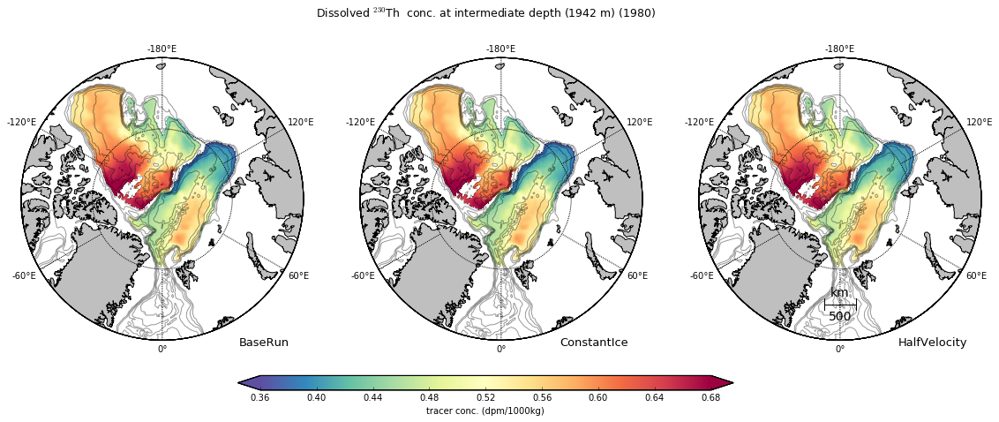

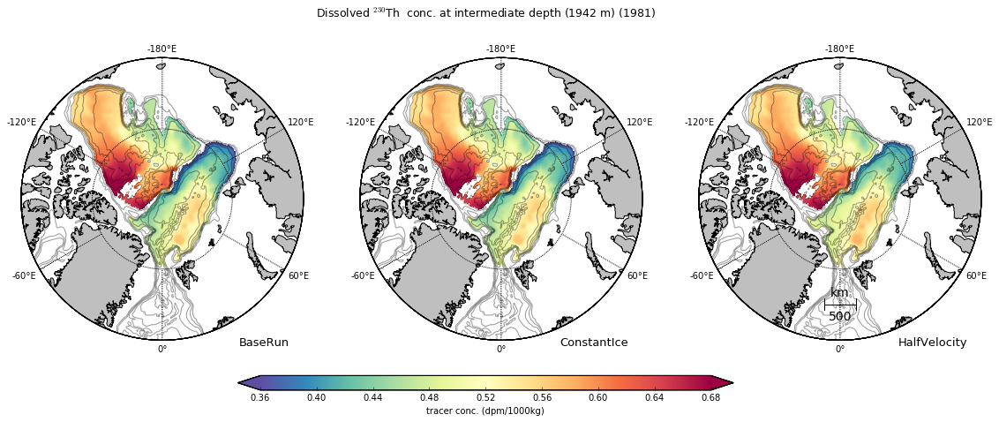

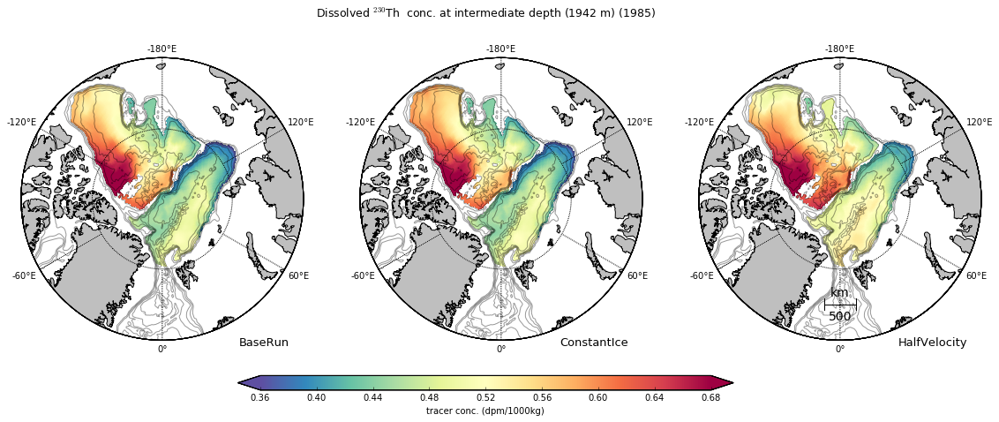

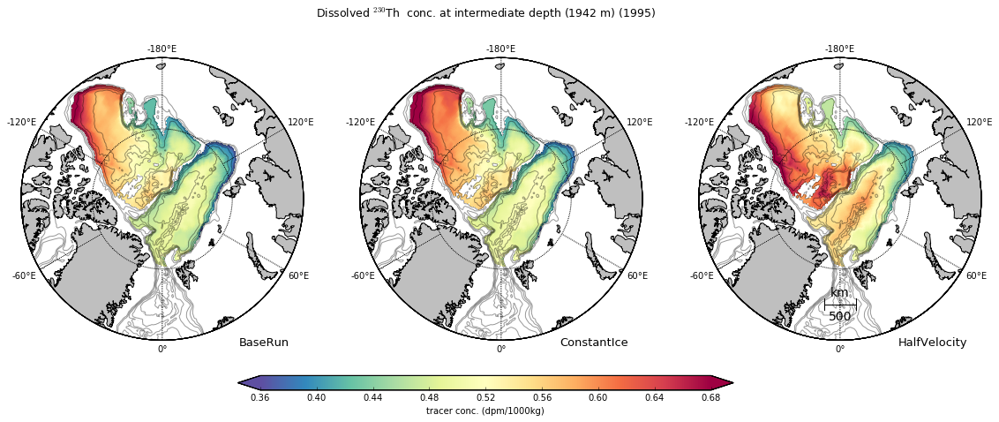

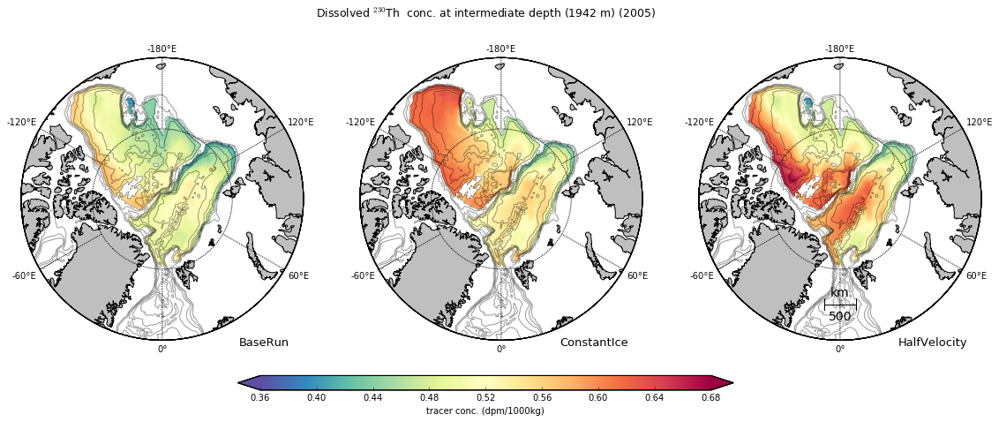

In [55]:
sens_th(nclist,Runname, Year, string='TR_8', title='Dissolved $^{230}$Th ',origyear=1979,layer=39,vkey='T',vmin=0.36,vmax=0.68) #1979-1984

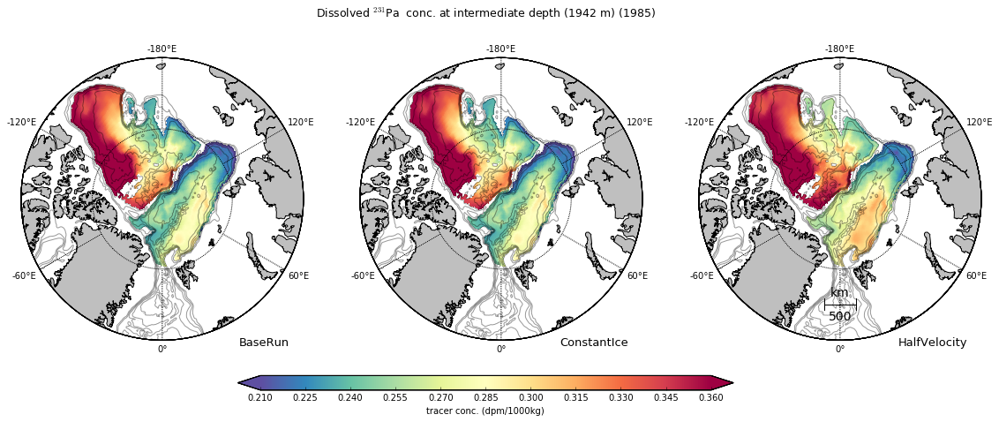

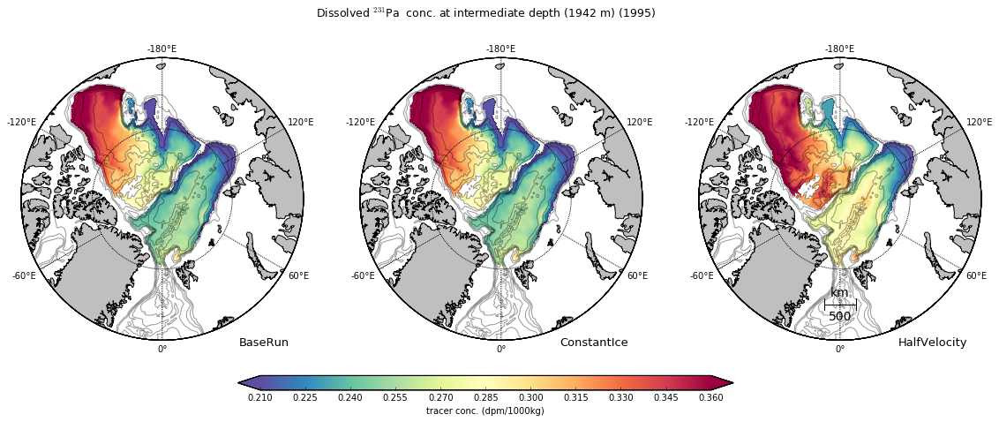

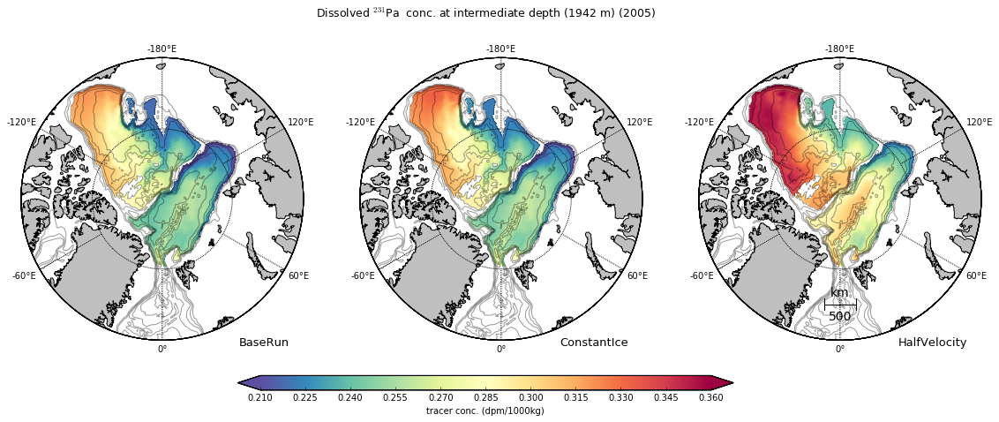

In [47]:
sens_th(nclist,Runname, Year, string='TR_7', title='Dissolved $^{231}$Pa ',origyear=1979,layer=39,vkey='T',vmin=0.21,vmax=0.36) #1979-1984

In [9]:
#  ratio below

/home/xiaoxiny/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:53: RuntimeWarning: invalid value encountered in true_divide


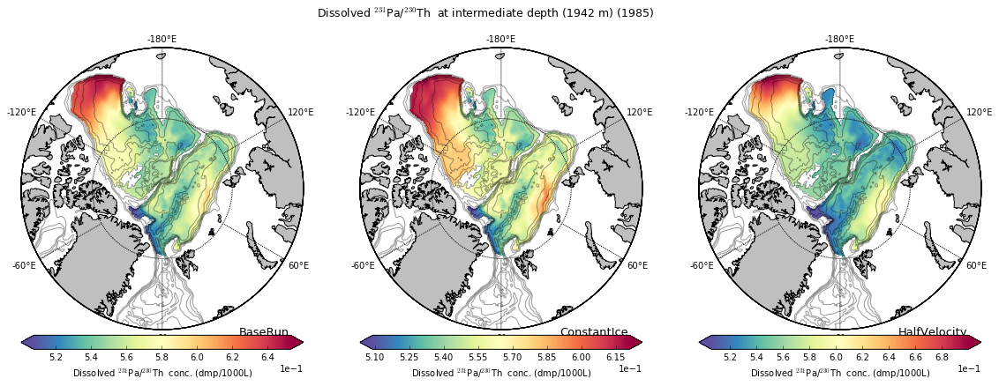

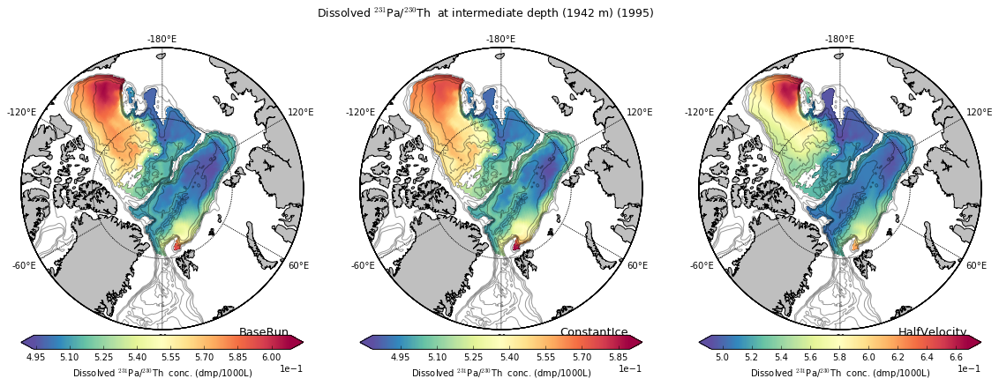

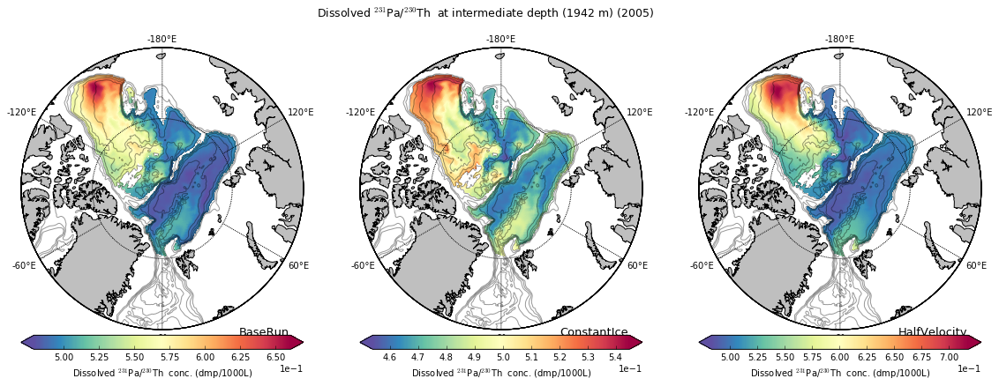

In [17]:
sens_ratio(nclist,Runname, Year, string='d', title='Dissolved $^{231}$Pa/$^{230}$Th ',origyear=1979,layer=39)#,vkey='T',vmin=0.21,vmax=0.36) #1979-1984

/home/xiaoxiny/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:55: RuntimeWarning: invalid value encountered in true_divide


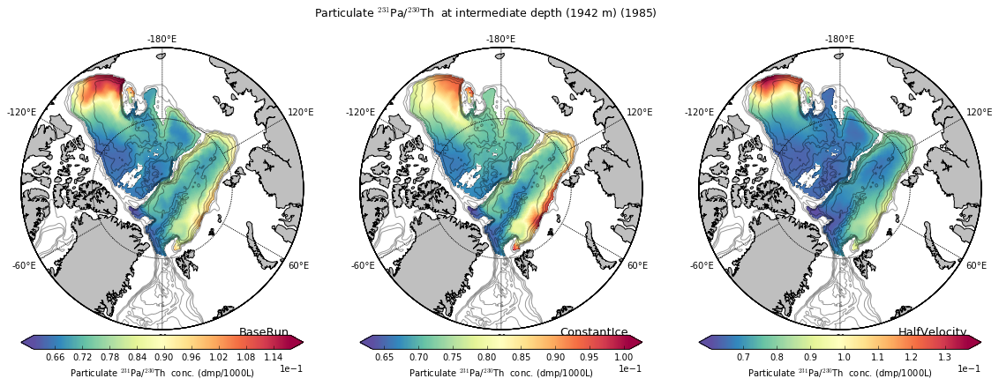

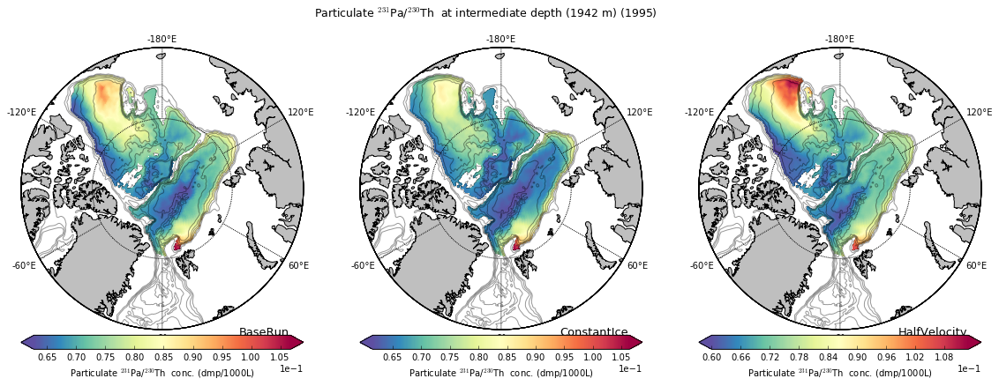

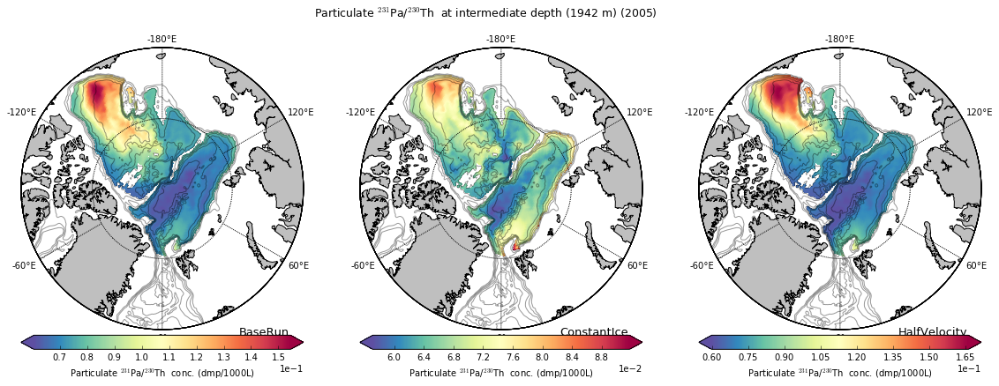

In [18]:
sens_ratio(nclist,Runname, Year, string='p', title='Particulate $^{231}$Pa/$^{230}$Th ',origyear=1979,layer=39)#,vkey='T',vmin=0.21,vmax=0.36) #1979-1984

In [10]:
nclist=['/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/result/ENG319582008.nc',
        '/ocean/xiaoxiny/research/result_jasper/min_ice/para60Run/result/ENG319582008.nc']

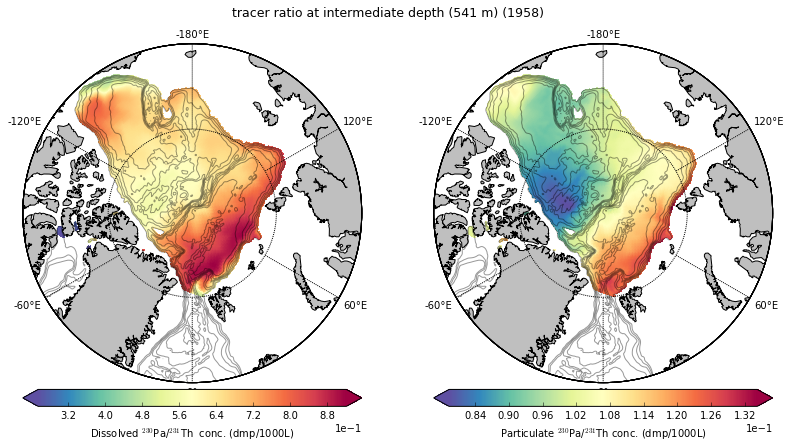

/home/xiaoxiny/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in true_divide
/home/xiaoxiny/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:9: RuntimeWarning: invalid value encountered in true_divide


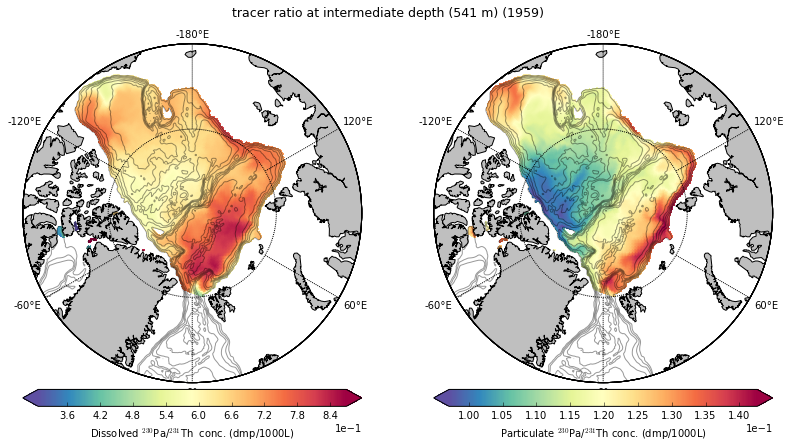

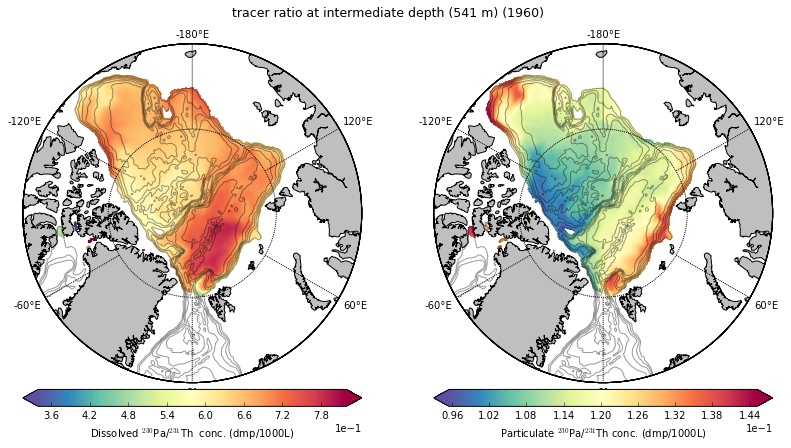

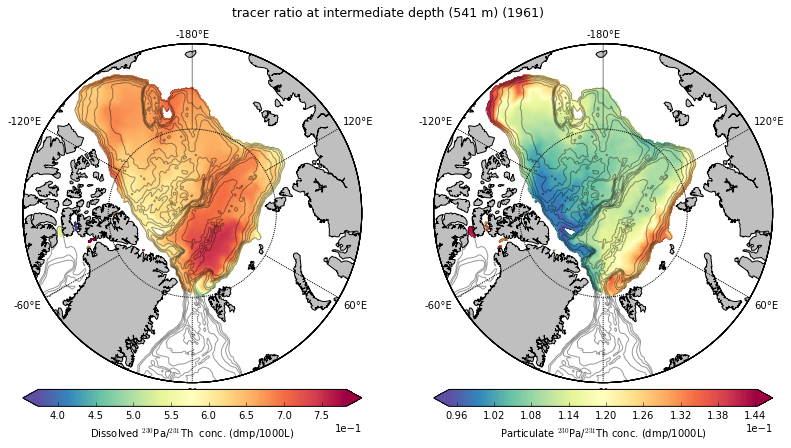

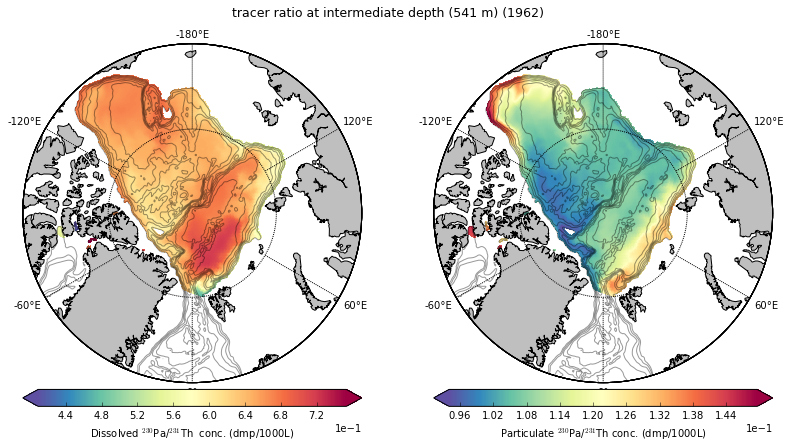

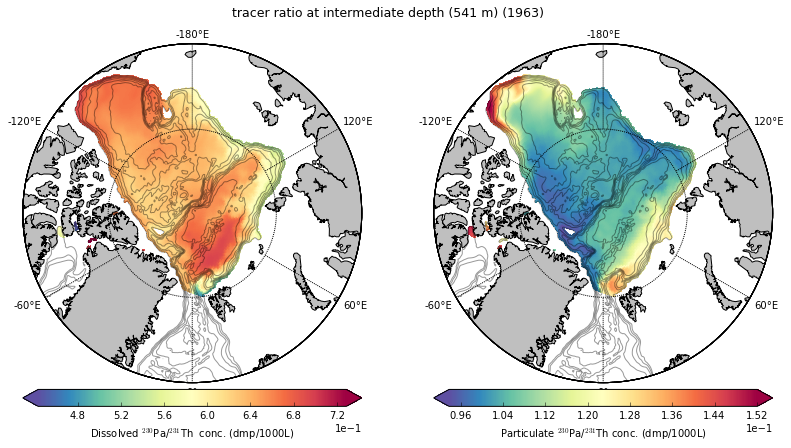

...

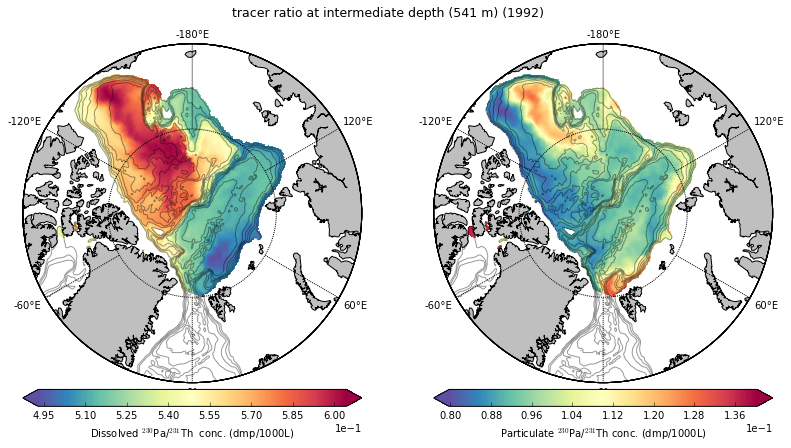

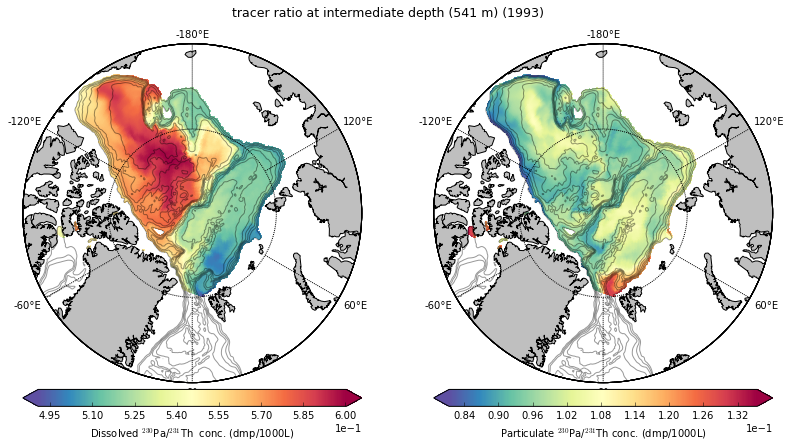

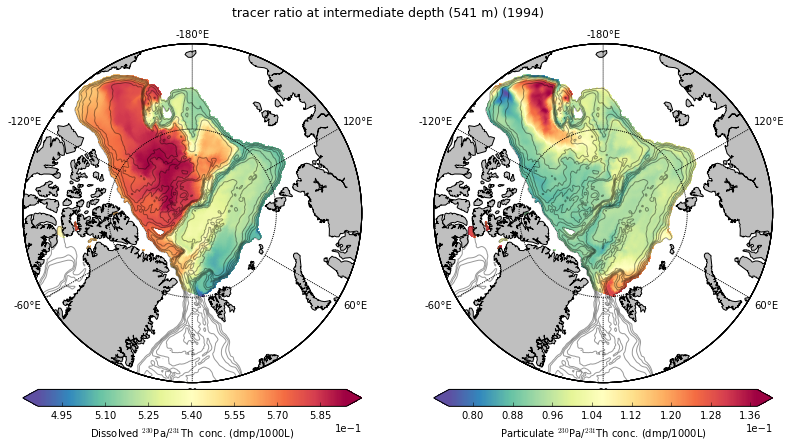

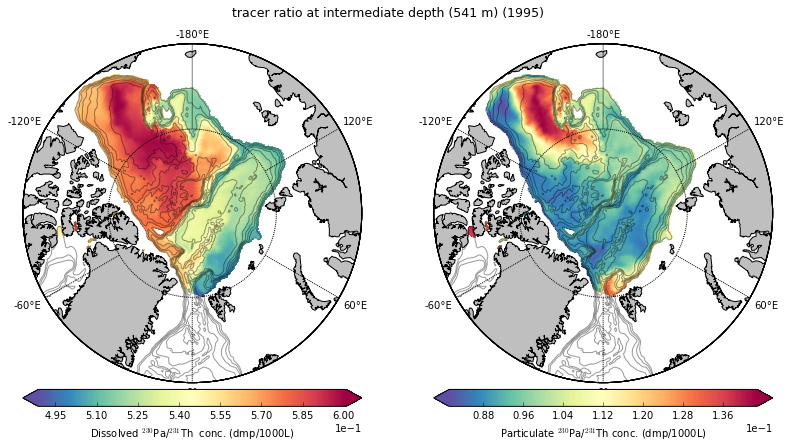

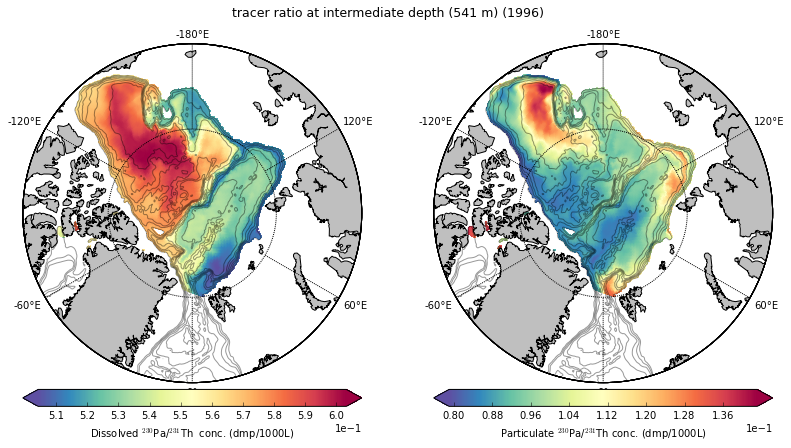

In [11]:
layer= 31
ptrc=nc.Dataset(nclist[0])
length=len(ptrc.variables['TR_7'][:,0,0,0])
for year in range (length):
    fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(13.5,6.5))
    for ax,time,nc_filename,string,title in \
    zip(axes.flat,[year,year], nclist,['d','p'],['Dissolved $^{230}$Pa/$^{231}$Th ','Particulate $^{230}$Pa/$^{231}$Th']):
        ptrc=nc.Dataset(nc_filename)
        if string == 'd':
            data =ptrc.variables['TR_7'][time,:,:,:]/ptrc.variables['TR_8'][time,:,:,:]
        else:
            data =ptrc.variables['TR_9'][time,:,:,:]/ptrc.variables['TR_10'][time,:,:,:]
        data =np.ma.masked_where(tmask==0,data)
        data[:,:125,:]=np.ma.masked

        m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l',round=True, ax=ax)
        m.drawcoastlines()
        m.fillcontinents(color = '0.75')
        m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
        m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
        x_lon,y_lat = m(lon,lat)
        # pcolor
        cs=m.pcolor(x_lon,y_lat,data[layer,:,:],cmap='Spectral_r'); 
        cbar=m.colorbar(cs,location='bottom',extend='both')
        cbar.set_label('%s conc. (dmp/1000L)'%(title))
        cbar.formatter.set_powerlimits((-1, 1))
        cbar.update_ticks()
        # bathy
        m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

    fig.suptitle(' tracer ratio at intermediate depth (%.0f m) (%s)'%(dep[layer],1958+year),fontsize=12.5)
    # Make an axis for the colorbar on the right side
    #cax = fig.add_axes([0.3, 0.05, 0.4, 0.04])
    #cbar=fig.colorbar(cs, orientation='horizontal',cax=cax)
    #cbar.set_label('tracer conc. (dpm/1000kg)')

    plt.show()

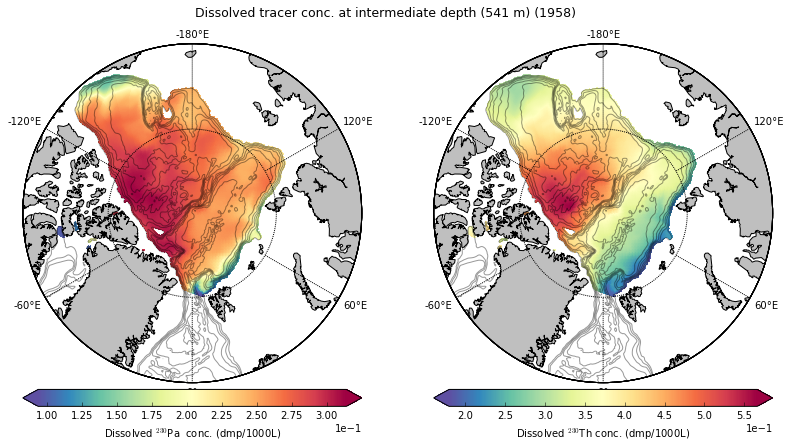

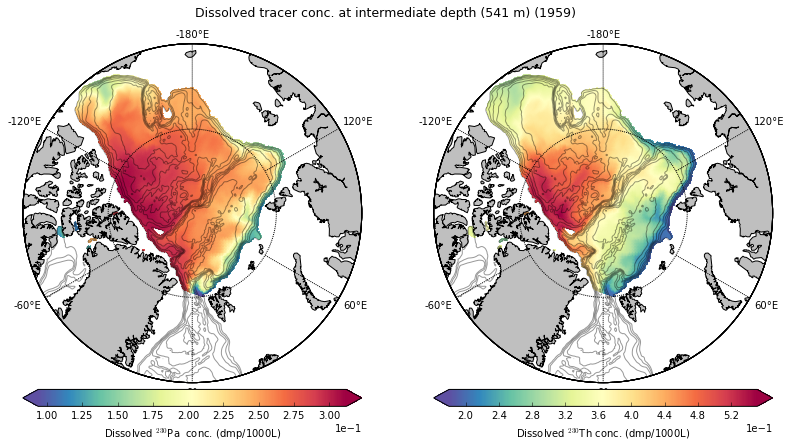

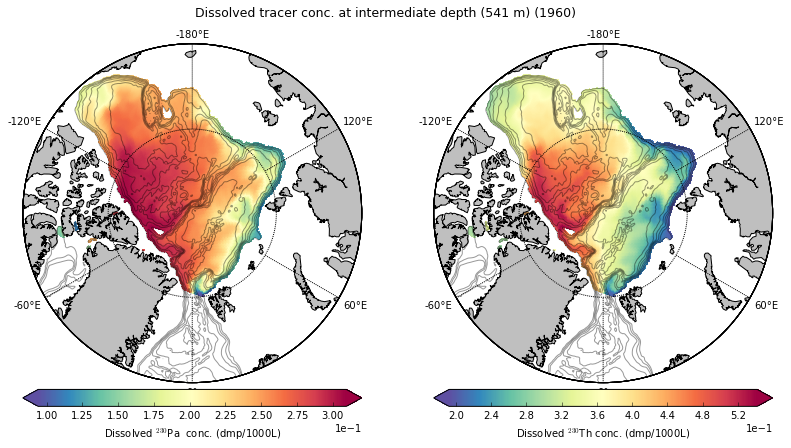

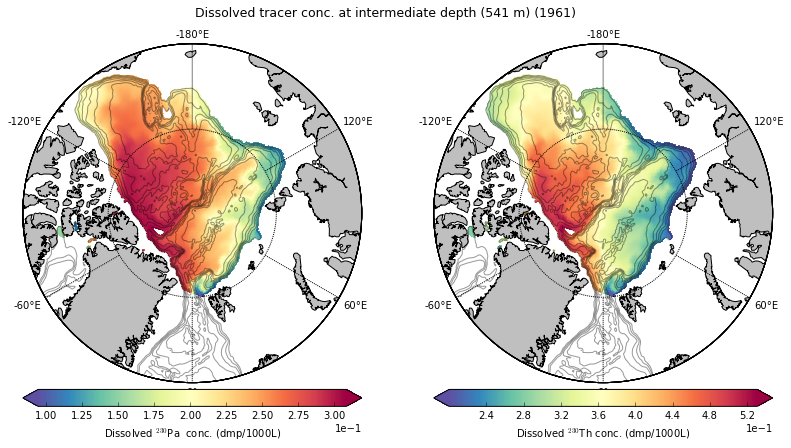

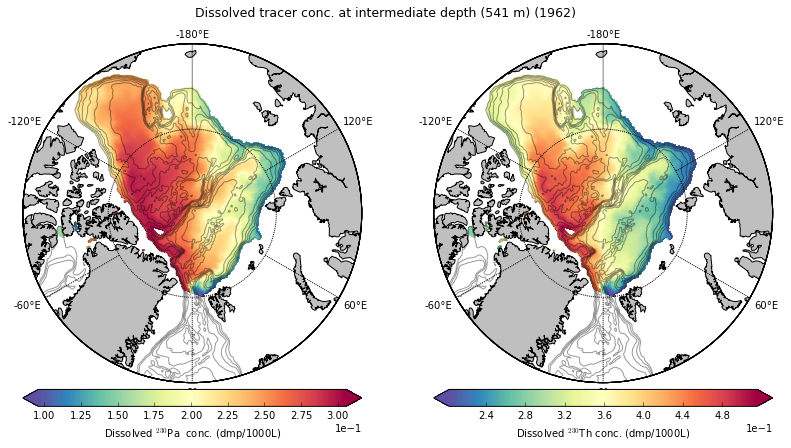

...

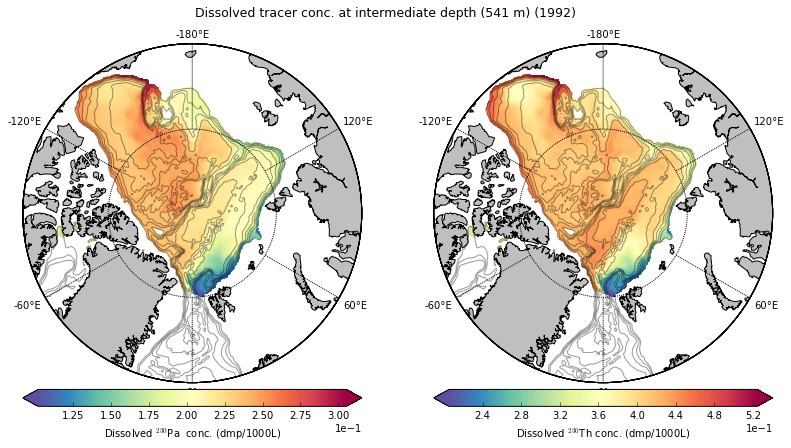

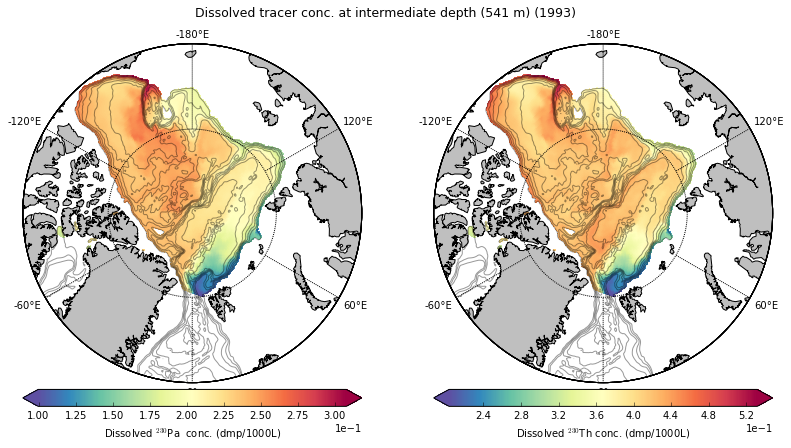

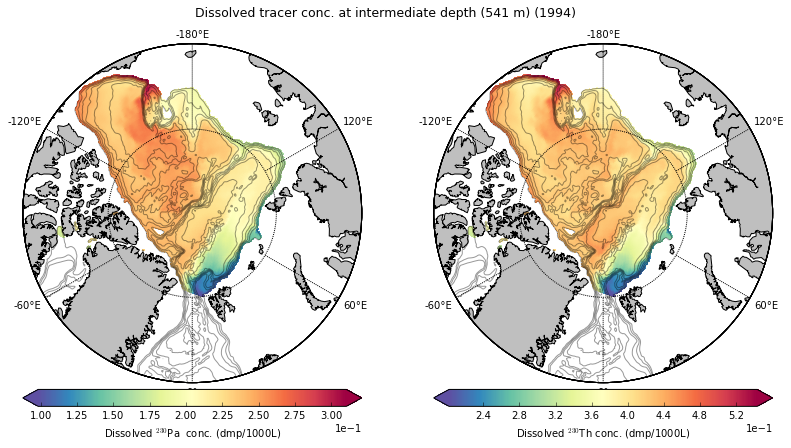

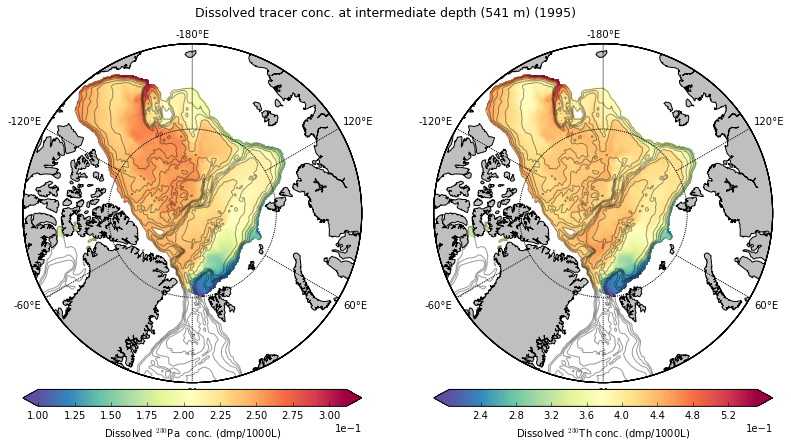

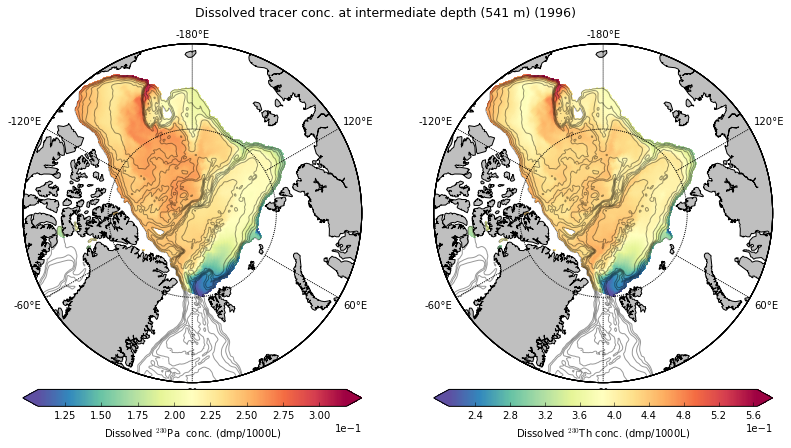

In [12]:
layer= 31
for year in range (length):
    fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(13.5,6.5))
    for ax,time,nc_filename,string,title in \
    zip(axes.flat,[year,year], nclist,['TR_7','TR_8'],['Dissolved $^{230}$Pa ','Dissolved $^{230}$Th']):
        ptrc=nc.Dataset(nc_filename)
        data =ptrc.variables[string][time,:,:,:]
        data =np.ma.masked_where(tmask==0,data)
        data[:,:125,:]=np.ma.masked

        m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l',round=True, ax=ax)
        m.drawcoastlines()
        m.fillcontinents(color = '0.75')
        m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
        m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
        x_lon,y_lat = m(lon,lat)
        # pcolor
        cs=m.pcolor(x_lon,y_lat,data[layer,:,:],cmap='Spectral_r'); 
        cbar=m.colorbar(cs,location='bottom',extend='both')
        cbar.set_label('%s conc. (dmp/1000L)'%(title))
        cbar.formatter.set_powerlimits((-1, 1))
        cbar.update_ticks()
        # bathy
        m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

    fig.suptitle('Dissolved tracer conc. at intermediate depth (%.0f m) (%s)'%(dep[layer],1958+year),fontsize=12.5)
    # Make an axis for the colorbar on the right side
    #cax = fig.add_axes([0.3, 0.05, 0.4, 0.04])
    #cbar=fig.colorbar(cs, orientation='horizontal',cax=cax)
    #cbar.set_label('tracer conc. (dpm/1000kg)')

    plt.show()